<a href="https://colab.research.google.com/github/B20G15/b20g15_automatic_image_captioning/blob/main/U5_CapstoneProject_ImageCaptioning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Advanced Certification in AIML
## A Program by IIIT-H and TalentSprint

## Problem Statement

Automatic Image Captioning

## Objectives
Build an image captioning model to generate captions of an image using CNN
Dataset Link: Flickr8k_dataset
Dataset description: A collection of sentence-based image description

● Dataset consists of 8k images in JPEG format with different shapes and sizes.

● Images are paired with five different captions which provide clear descriptions of the salient entities and events.

● The images were chosen from six different Flickr groups and included a variety of scenes and situations.

## Dataset

Flickr8k_datase - https://github.com/goodwillyoga/Flickr8k_dataset

## Setup Steps

In [ ]:
#@title Run this cell to complete the setup for this Notebook

from IPython import get_ipython
ipython = get_ipython()

notebook= "U4_Mini_Hackathon2_Image_Transformations" #name of the notebook
Answer = "This notebook is graded by mentors on the day of hackathon"
def setup():
   ipython.magic("sx wget https://cdn.iiith.talentsprint.com/aiml/Experiment_related_data/Image_Transformations.zip")
   ipython.magic("sx unzip -qq Image_Transformations.zip")
   print ("Setup completed successfully")
   return

setup()

Setup completed successfully


In [ ]:
%ls

Image_Transformations/  Image_Transformations.zip  sample_data/


## Basic Pytorch packages

**torchvision:**  This package is used to load and prepare the dataset. Using this package we can perform/apply transformations on the input data.

**transforms:**  This package is  used to perform **preprocessing on images** and operations sequentially.

**nn:**  This package provides an easy and modular way to build and train simple or complex neural networks.

**optim:** This package is used for  implementing various optimization algorithms

In [ ]:
# Import Libraries
import matplotlib.pyplot as plt
import torch
from torch import nn
from torch import optim
import torch.nn.functional as F
from torchvision import datasets, transforms, models
from torch.autograd import Variable

import pandas as pd
import numpy as np
import os

from PIL import Image

from IPython import get_ipython
ipython = get_ipython()

In [ ]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
ipython.magic("sx unzip -qq /content/drive/MyDrive/Dataset/Flickr8k_Dataset.zip")


[]

In [ ]:
ipython.magic("sx unzip -qq /content/drive/MyDrive/Dataset/captions.txt.zip")

['replace captions.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: A']

In [ ]:
from numpy import expand_dims
image_size = (128,128)

# YOUR CODE HERE for defining Transformation for an image
transformations = transforms.Compose([
    transforms.Resize(image_size),
    transforms.Grayscale(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

In [ ]:
# Load data
images_dir = os.listdir("../input/flickr_data/Flickr_Data/")

images_path = '../input/flickr_data/Flickr_Data/Images/'
captions_path = '../input/flickr_data/Flickr_Data/Flickr_TextData/Flickr8k.token.txt'
train_path = '../input/flickr_data/Flickr_Data/Flickr_TextData/Flickr_8k.trainImages.txt'
val_path = '../input/flickr_data/Flickr_Data/Flickr_TextData/Flickr_8k.devImages.txt'
test_path = '../input/flickr_data/Flickr_Data/Flickr_TextData/Flickr_8k.testImages.txt'

captions = open(captions_path, 'r').read().split("\n")
x_train = open(train_path, 'r').read().split("\n")
x_val = open(val_path, 'r').read().split("\n")
x_test = open(test_path, 'r').read().split("\n")

FileNotFoundError: ignored

### 1 Mark -> Load the training dataset

In [ ]:
# loader =  # YOUR CODE HERE for defining Transformation for an image

# Define transformations for the images
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [ ]:
# YOUR CODE HERE for the DataLoader

from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder


train_data = ImageFolder('/content/Image_Transformations/training/', transform=transform)
train_loader = DataLoader(train_data, batch_size=32, shuffle=True)



## **Stage 2:** Load and Finetune a pre-trained model

Load a pretrained model and finetune the appropriate layers



###  2 Marks -> Fine-tune the Model and declare the loss function and optimizer.

[Hint for Finetuning Models](https://pytorch.org/tutorials/beginner/finetuning_torchvision_models_tutorial.html)

Initialize the device to the available runtime type

In [ ]:
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device = torch.device("cuda")
print(device)

cuda


In [ ]:
# YOUR CODE HERE for the loading and finetuning the Pre-trained model
# YOUR CODE HERE for declaring the loss function and optimizer

from torchvision.models import resnet18

# Load the pre-trained ResNet18 model
model = resnet18(pretrained=True)

# Fine-tune the last fully connected layer of the model
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 6)  # 6 is the number of output classes
model = model.to(device)

# Declare the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 266MB/s]


### 2 Marks -> Train the Model to calculate the loss and accuracy for the dataset across each epoch.

Iterate over batch-wise images in the train_loader and perform the following steps.

1. First, zero out the gradients using zero_grad()

2. Convert the inputs, labels to the device (runtime type: GPU or CPU)

3. Pass the input to the model and get the output

4. Calculate the loss by comparing output with actual labels using a Loss function

5. Perform Backward pass using backward() to update the weights

6. Optimize the weights at each epoch and get a high probability prediction using the torch.max()

7. Calculate the accuracy of the training dataset using the predictions

**Note:** Optimize the  model to get better accuracy.

## Expected Accuracy > 90%

In [ ]:
# YOUR CODE HERE
# Record loss and accuracy of the training dataset for each epoch

# Train the model
num_epochs = 6
for epoch in range(num_epochs):
    running_loss = 0.0
    running_corrects = 0.0
    for inputs, labels in train_loader:
        # Zero out the gradients
        optimizer.zero_grad()

        # Convert inputs and labels to the device
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)

        # Calculate the loss
        loss = criterion(outputs, labels)

        # Backward pass and optimization
        loss.backward()
        optimizer.step()

        # Update running loss and accuracy
        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(train_data)
    epoch_acc = running_corrects / len(train_data)

    print('Epoch [{}/{}], Loss: {:.4f}, Accuracy: {:.4f}'.format(epoch+1, num_epochs, epoch_loss, epoch_acc))


Epoch [1/6], Loss: 0.2388, Accuracy: 0.9188
Epoch [2/6], Loss: 0.1599, Accuracy: 0.9461
Epoch [3/6], Loss: 0.1085, Accuracy: 0.9639
Epoch [4/6], Loss: 0.0703, Accuracy: 0.9778
Epoch [5/6], Loss: 0.0465, Accuracy: 0.9877
Epoch [6/6], Loss: 0.0320, Accuracy: 0.9929


### 1 Marks -> Validate the Model using the validation data

Iterate over batch-wise images in the validation_loader and perform the following steps.

1. First, set the model in `eval()` mode

2. Convert the inputs, labels to the device (runtime type: GPU or CPU)

3. Pass the input to the model and get the output

4. Get high probability prediction using the torch.max()

5. Calculate the accuracy of the validation dataset using the predictions


## Expected Accuracy > 90%

**Note:** Optimize the model to get better accuracy

[Hint for eval()](https://pytorch.org/docs/stable/generated/torch.nn.Module.html#torch.nn.Module.eval)


In [ ]:
# YOUR CODE HERE
# Display the accuracy of the validation dataset

validation_data = ImageFolder('/content/Image_Transformations/validation/', transform=transform)
validation_loader = DataLoader(validation_data, batch_size=32, shuffle=True)

model.eval()

validation_accuracy = 0
predictions, test_images1 = [], []
# Iterate through all the batches in each epoch
for images,labels in validation_loader:
    # Convert the images and labels to gpu for faster execution
    images = images.to(device)
    labels = labels.to(device)

    # Do the forward pass
    outputs = model(images)

    # Accuracy calculation
    _, predicted = torch.max(outputs, 1)
    validation_accuracy += (predicted == labels).sum().item()
    test_images1.extend(images.cpu())
    predictions.extend(predicted.cpu())

Accuracy = validation_accuracy / len(validation_data)
print("Accuracy of Validation Data is", Accuracy)

Accuracy of Validation Data is 0.9356666666666666


## **Stage 3:** Test your final architecture on variations of the Test data.



Variations of the Test data mean that you can consider any image transformation such as Brightness, rotation, flip, and so on, as shown in the below example.

![alt text](https://cdn.iiith.talentsprint.com/aiml/Experiment_related_data/transformations.png)

### 4 Marks-> Define 6 different types of image transformation (variations) and evaluate for all test samples of various classes available.

1. Define 6 image transformations (Eg: Brightness, rotate, flip, and so on). You can use either skimage, PIL, or anything which can give the image transformations.

2. Iterate over all **<font size='4.5'>TEN </font>** different test samples available under the testing folder run the below steps
   *  Perform 6 different image transformations for the chosen test sample and plot the same.
   *  Convert the image type of the transformed images, if required.
   *  Call the image_loader function for every transformed image.
   *  Pass through the  model to predict the label for each transformed test sample.
   *  Ensure the transformed test sample gives the correct prediction as an appropriate class name (buildings, forest, glacier, mountain, sea, and street) and **visualize** the same

### At least 4 transformed pictures should be predicted similar to each original base prediction

[Hint for the image transformations using skimage](https://www.analyticsvidhya.com/blog/2019/09/9-powerful-tricks-for-working-image-data-skimage-python/)

[Hint for the image transformations using PIL](https://machinelearningmastery.com/how-to-load-and-manipulate-images-for-deep-learning-in-python-with-pil-pillow/)

In [ ]:
# Import required libraries for image transformations

from PIL import ImageOps, ImageEnhance
from torchvision import transforms


In [ ]:
def image_loader(image):
    image = loader(image).to(device)
    image = image.unsqueeze(0) # To pass single image through the model
    return image

In [ ]:
# YOUR CODE HERE for defining 6 different image transformations (eg: Brightness, rotate, flip, and so on)

transformations = [
    transforms.RandomRotation(30),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.ColorJitter(brightness=0.5),
    transforms.ColorJitter(contrast=0.5),
    transforms.ColorJitter(saturation=0.5)
]

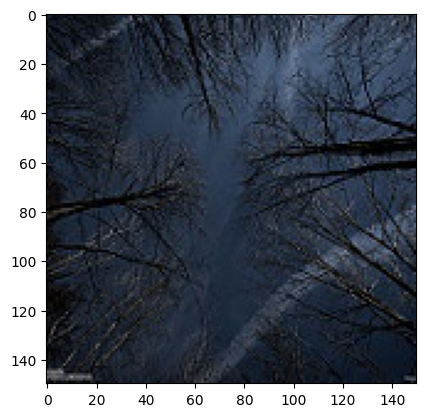

Transformed image 1 predicted as glacier
RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)


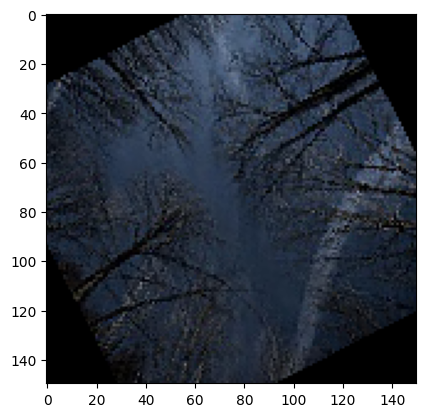

Transformed image 1 predicted as forest
RandomHorizontalFlip(p=0.5)


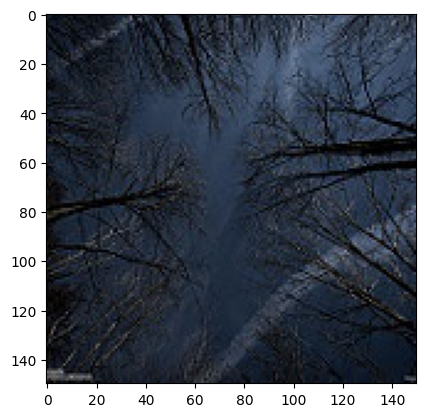

Transformed image 1 predicted as glacier
RandomVerticalFlip(p=0.5)


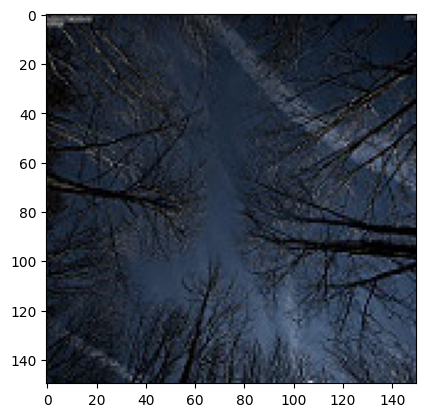

Transformed image 1 predicted as forest
ColorJitter(brightness=(0.5, 1.5), contrast=None, saturation=None, hue=None)


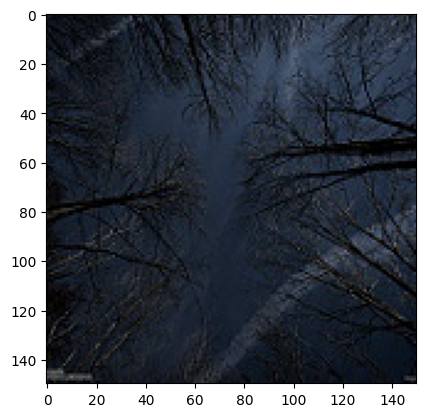

Transformed image 1 predicted as forest
ColorJitter(brightness=None, contrast=(0.5, 1.5), saturation=None, hue=None)


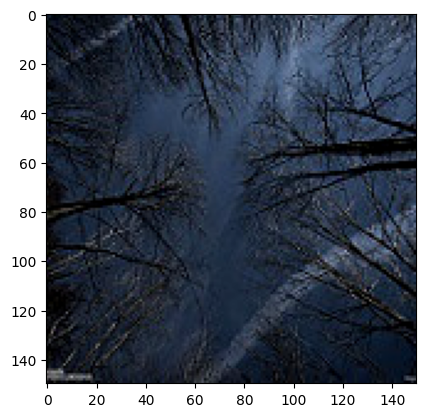

Transformed image 1 predicted as forest
ColorJitter(brightness=None, contrast=None, saturation=(0.5, 1.5), hue=None)


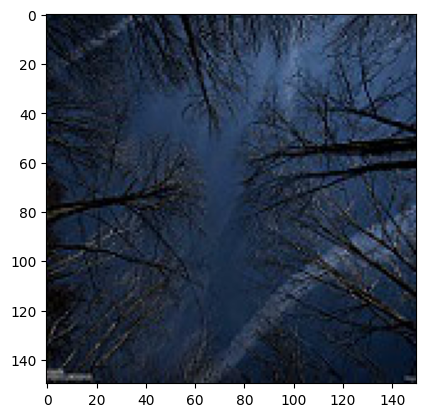

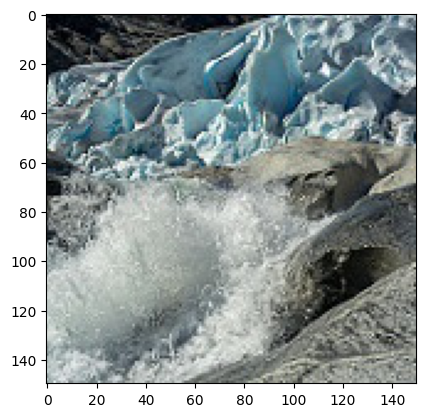

Transformed image 2 predicted as glacier
RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)


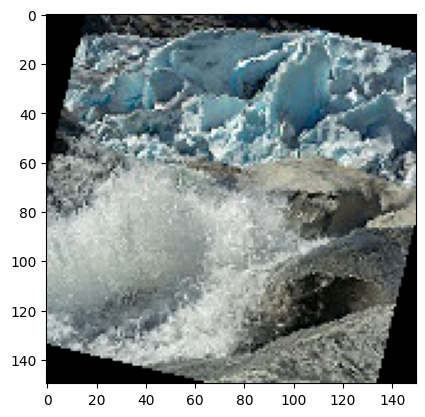

Transformed image 2 predicted as glacier
RandomHorizontalFlip(p=0.5)


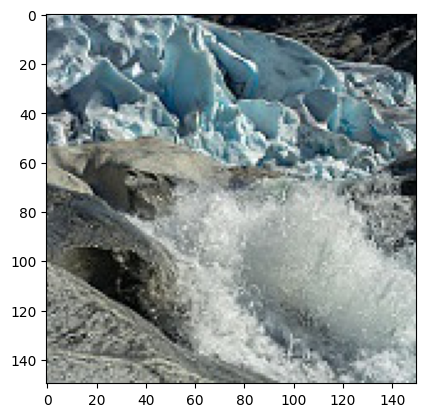

Transformed image 2 predicted as glacier
RandomVerticalFlip(p=0.5)


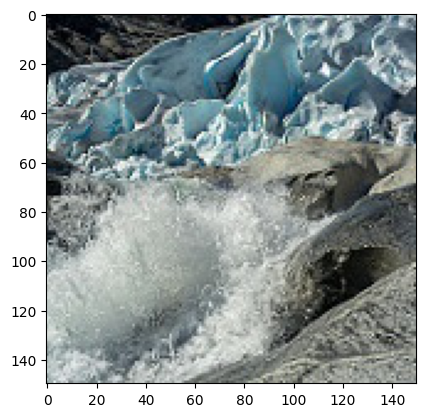

Transformed image 2 predicted as glacier
ColorJitter(brightness=(0.5, 1.5), contrast=None, saturation=None, hue=None)


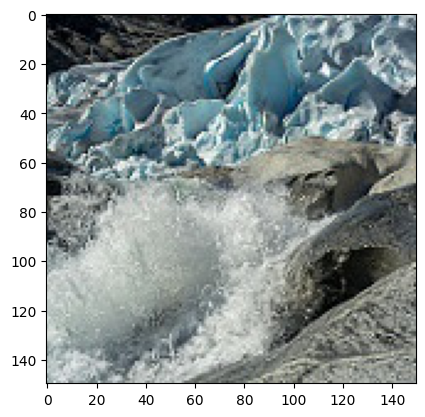

Transformed image 2 predicted as glacier
ColorJitter(brightness=None, contrast=(0.5, 1.5), saturation=None, hue=None)


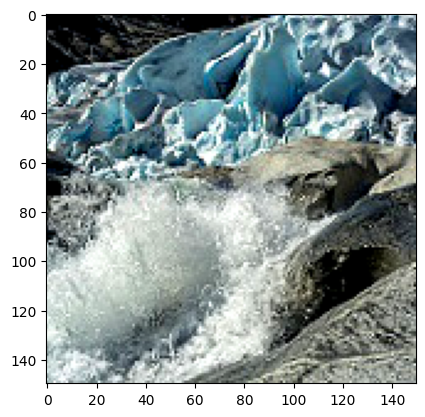

Transformed image 2 predicted as glacier
ColorJitter(brightness=None, contrast=None, saturation=(0.5, 1.5), hue=None)


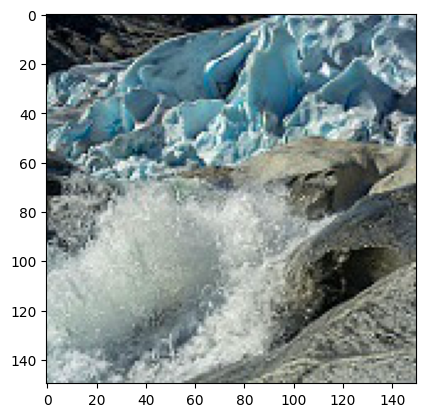

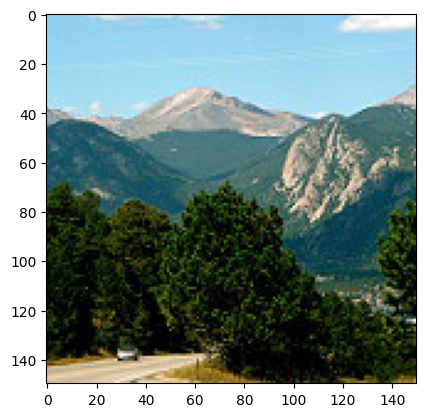

Transformed image 3 predicted as glacier
RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)


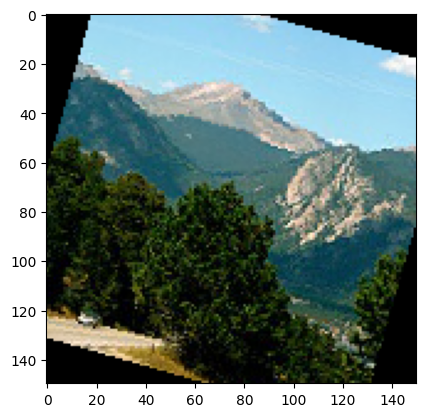

Transformed image 3 predicted as mountain
RandomHorizontalFlip(p=0.5)


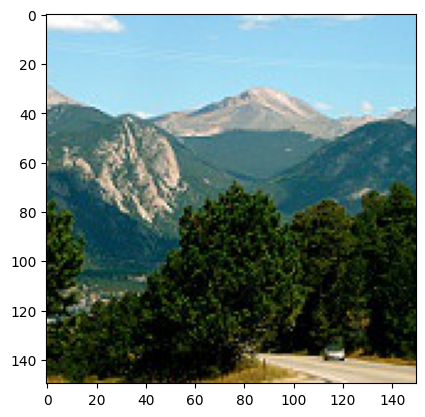

Transformed image 3 predicted as glacier
RandomVerticalFlip(p=0.5)


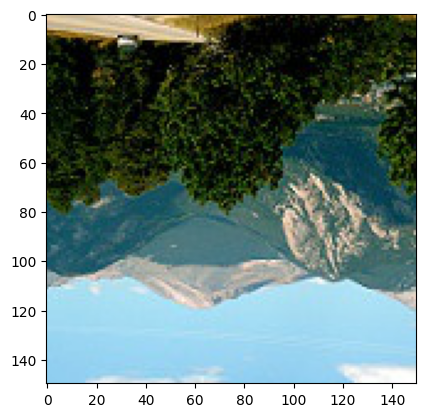

Transformed image 3 predicted as mountain
ColorJitter(brightness=(0.5, 1.5), contrast=None, saturation=None, hue=None)


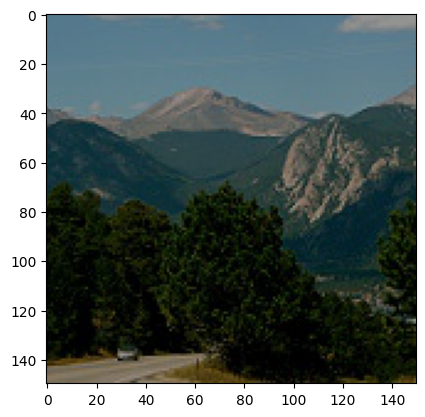

Transformed image 3 predicted as mountain
ColorJitter(brightness=None, contrast=(0.5, 1.5), saturation=None, hue=None)


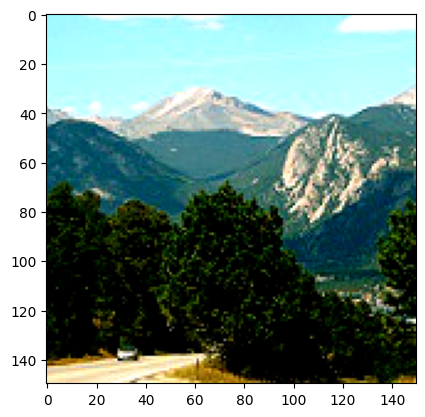

Transformed image 3 predicted as mountain
ColorJitter(brightness=None, contrast=None, saturation=(0.5, 1.5), hue=None)


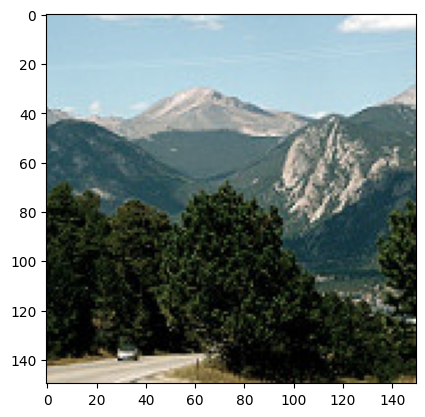

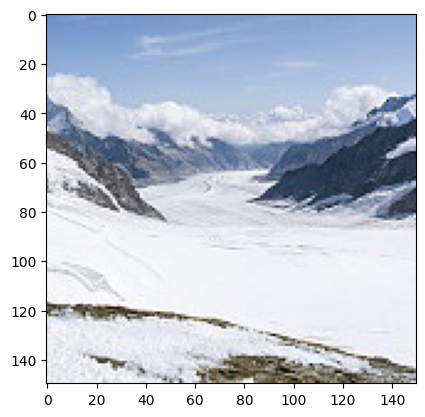

Transformed image 4 predicted as glacier
RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)


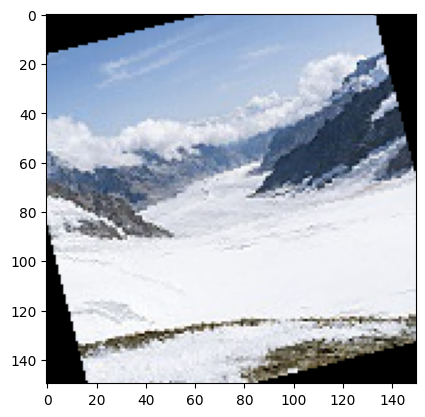

Transformed image 4 predicted as glacier
RandomHorizontalFlip(p=0.5)


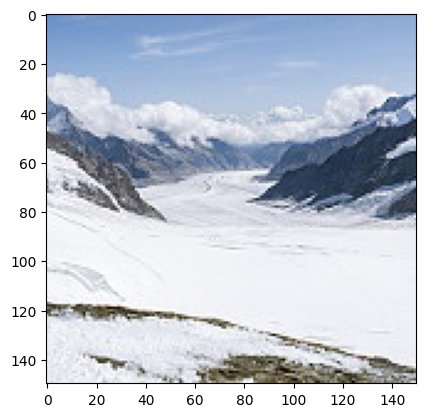

Transformed image 4 predicted as glacier
RandomVerticalFlip(p=0.5)


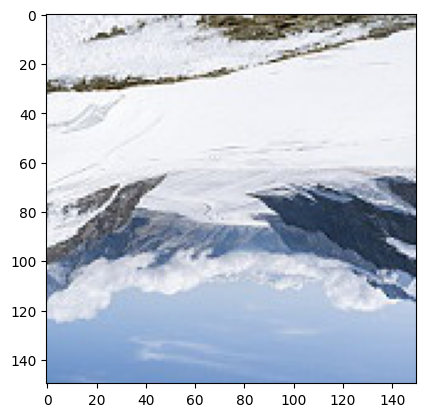

Transformed image 4 predicted as glacier
ColorJitter(brightness=(0.5, 1.5), contrast=None, saturation=None, hue=None)


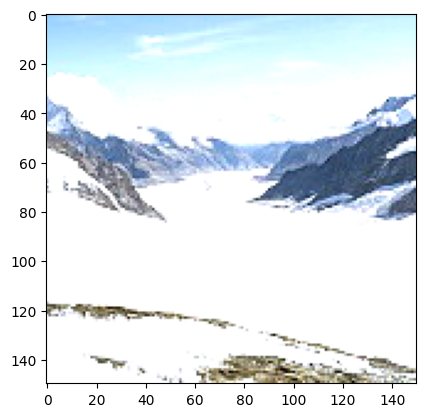

Transformed image 4 predicted as glacier
ColorJitter(brightness=None, contrast=(0.5, 1.5), saturation=None, hue=None)


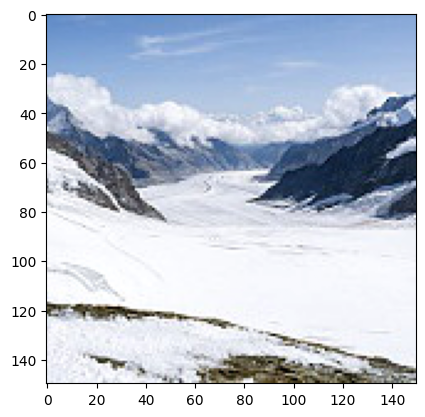

Transformed image 4 predicted as glacier
ColorJitter(brightness=None, contrast=None, saturation=(0.5, 1.5), hue=None)


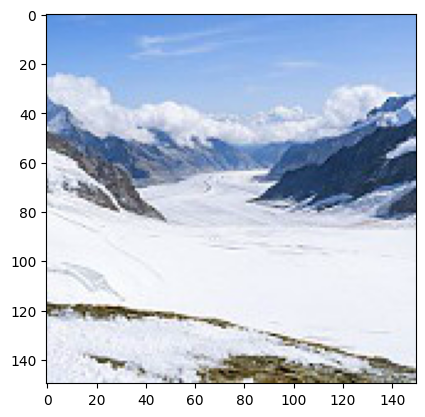

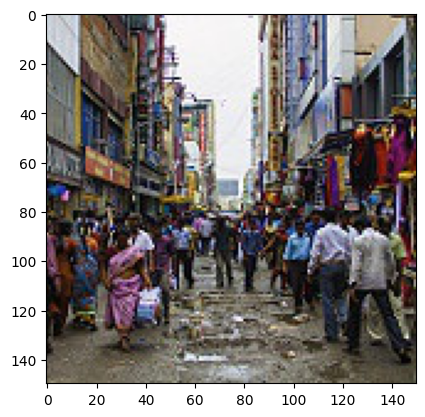

Transformed image 5 predicted as glacier
RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)


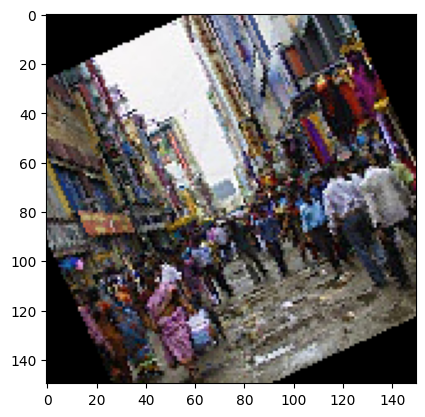

Transformed image 5 predicted as street
RandomHorizontalFlip(p=0.5)


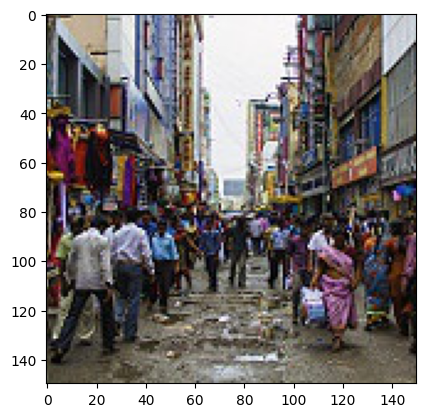

Transformed image 5 predicted as street
RandomVerticalFlip(p=0.5)


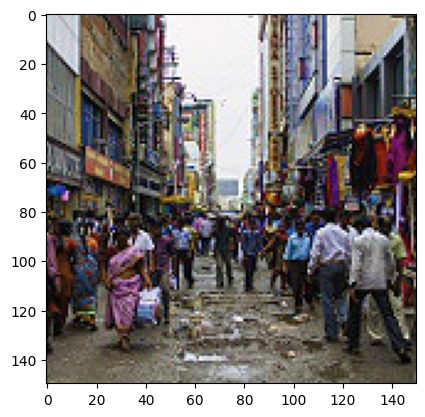

Transformed image 5 predicted as street
ColorJitter(brightness=(0.5, 1.5), contrast=None, saturation=None, hue=None)


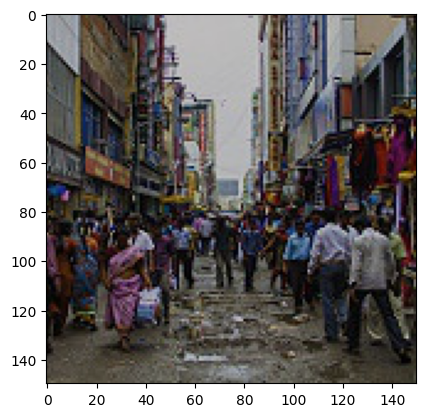

Transformed image 5 predicted as street
ColorJitter(brightness=None, contrast=(0.5, 1.5), saturation=None, hue=None)


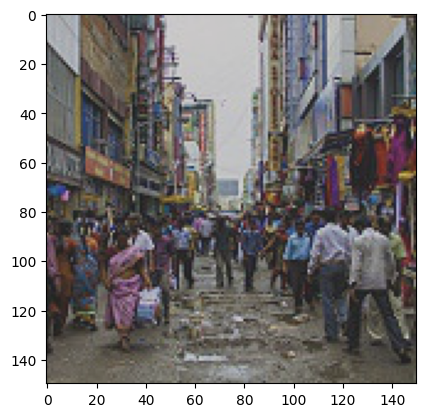

Transformed image 5 predicted as street
ColorJitter(brightness=None, contrast=None, saturation=(0.5, 1.5), hue=None)


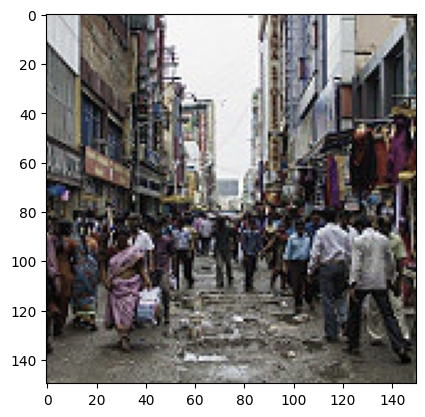

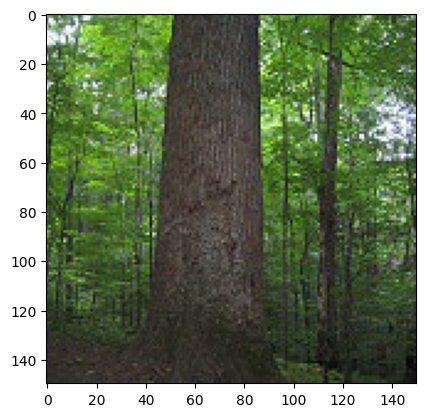

Transformed image 6 predicted as glacier
RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)


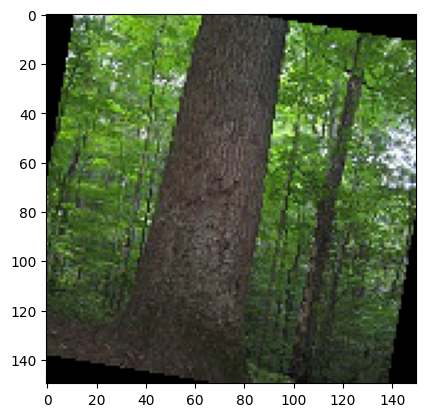

Transformed image 6 predicted as forest
RandomHorizontalFlip(p=0.5)


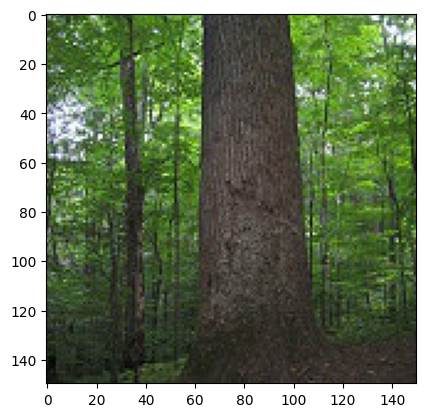

Transformed image 6 predicted as forest
RandomVerticalFlip(p=0.5)


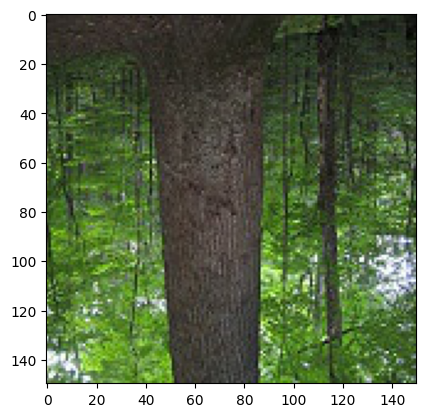

Transformed image 6 predicted as forest
ColorJitter(brightness=(0.5, 1.5), contrast=None, saturation=None, hue=None)


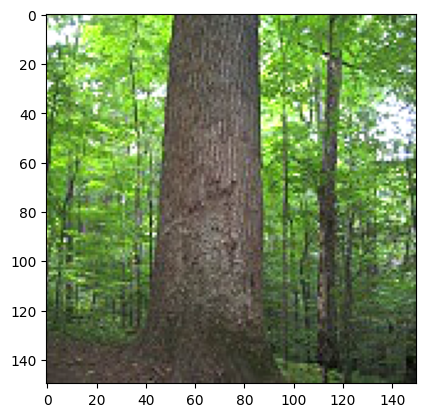

Transformed image 6 predicted as forest
ColorJitter(brightness=None, contrast=(0.5, 1.5), saturation=None, hue=None)


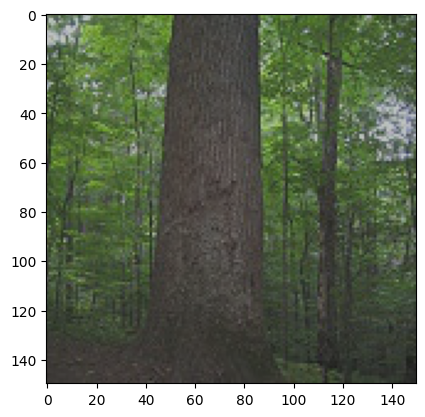

Transformed image 6 predicted as forest
ColorJitter(brightness=None, contrast=None, saturation=(0.5, 1.5), hue=None)


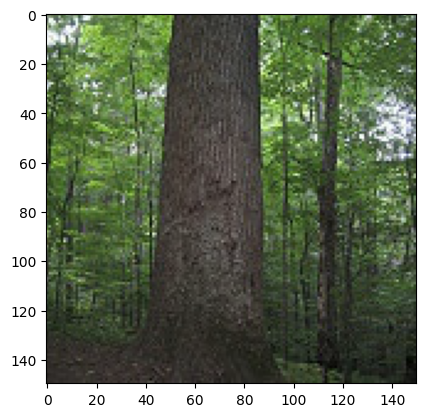

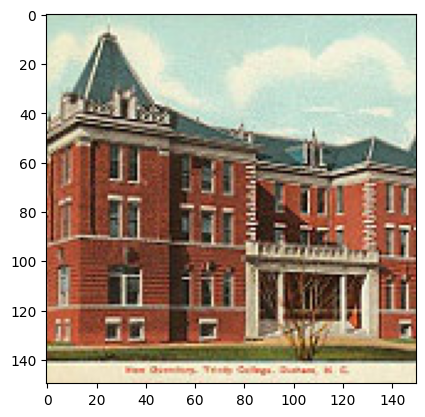

Transformed image 7 predicted as buildings
RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)


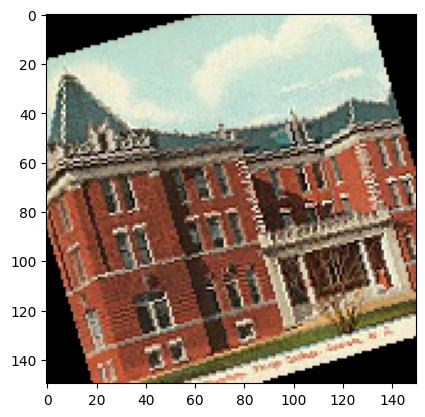

Transformed image 7 predicted as buildings
RandomHorizontalFlip(p=0.5)


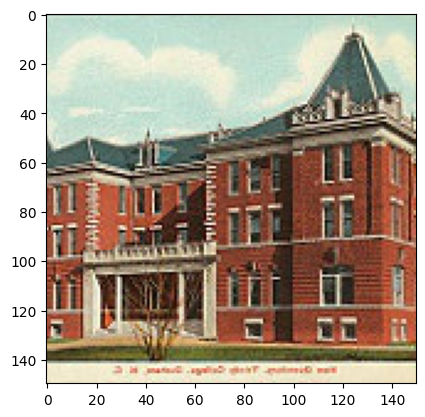

Transformed image 7 predicted as buildings
RandomVerticalFlip(p=0.5)


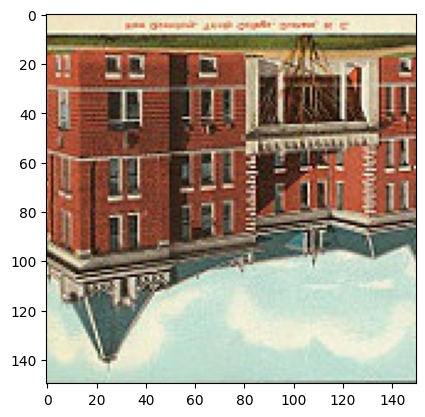

Transformed image 7 predicted as buildings
ColorJitter(brightness=(0.5, 1.5), contrast=None, saturation=None, hue=None)


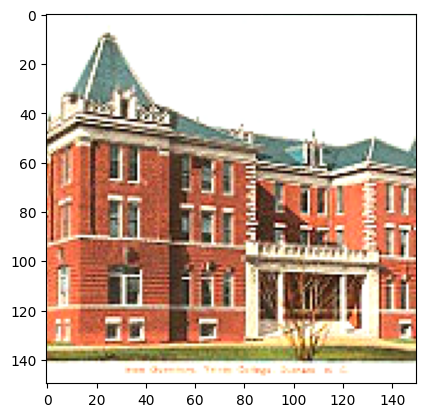

Transformed image 7 predicted as buildings
ColorJitter(brightness=None, contrast=(0.5, 1.5), saturation=None, hue=None)


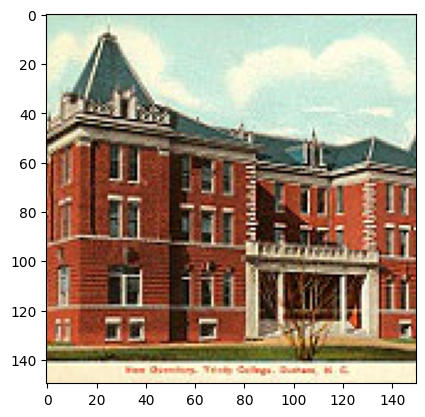

Transformed image 7 predicted as buildings
ColorJitter(brightness=None, contrast=None, saturation=(0.5, 1.5), hue=None)


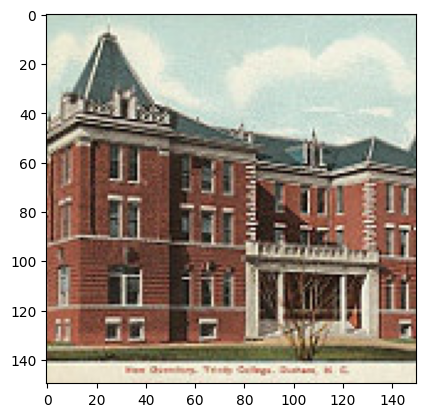

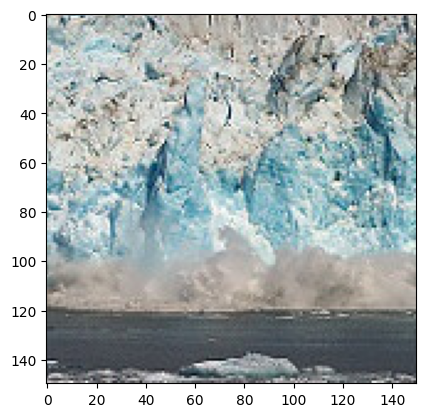

Transformed image 8 predicted as glacier
RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)


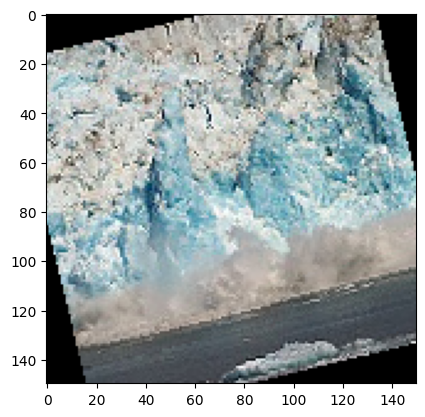

Transformed image 8 predicted as glacier
RandomHorizontalFlip(p=0.5)


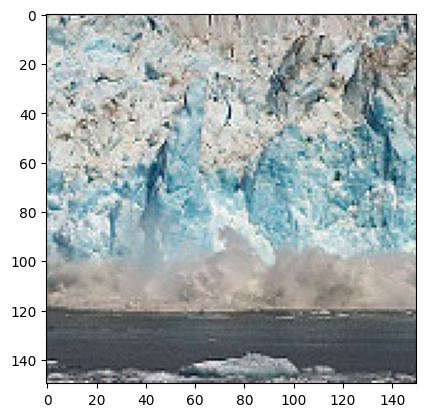

Transformed image 8 predicted as glacier
RandomVerticalFlip(p=0.5)


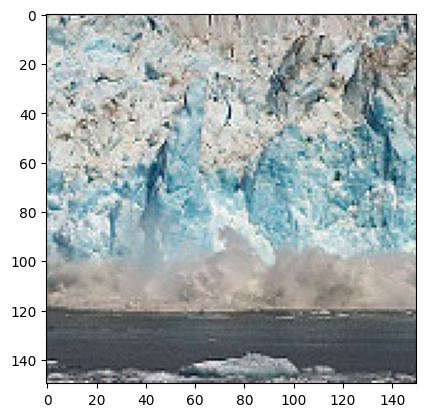

Transformed image 8 predicted as glacier
ColorJitter(brightness=(0.5, 1.5), contrast=None, saturation=None, hue=None)


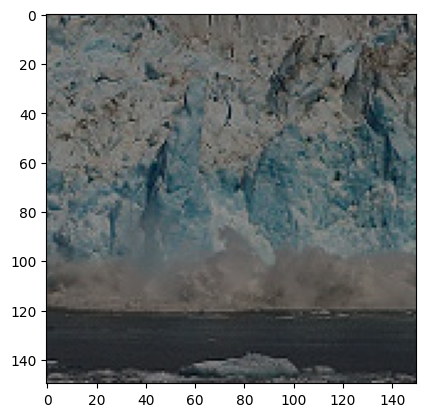

Transformed image 8 predicted as glacier
ColorJitter(brightness=None, contrast=(0.5, 1.5), saturation=None, hue=None)


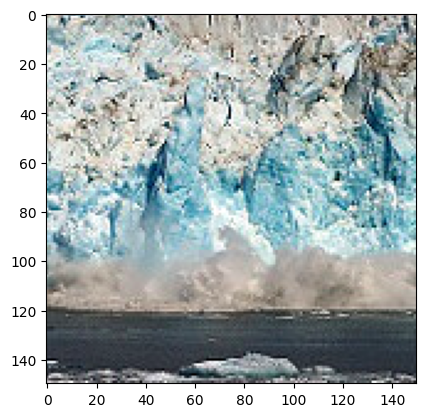

Transformed image 8 predicted as glacier
ColorJitter(brightness=None, contrast=None, saturation=(0.5, 1.5), hue=None)


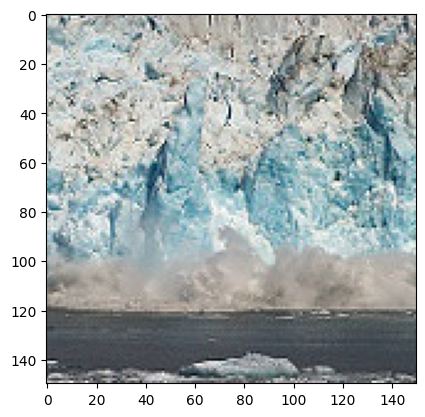

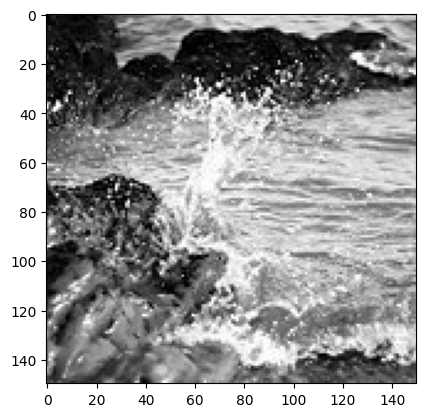

Transformed image 9 predicted as glacier
RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)


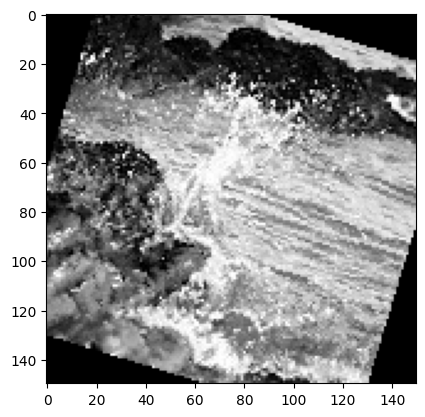

Transformed image 9 predicted as sea
RandomHorizontalFlip(p=0.5)


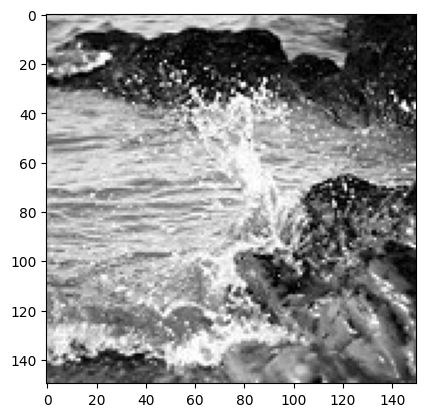

Transformed image 9 predicted as glacier
RandomVerticalFlip(p=0.5)


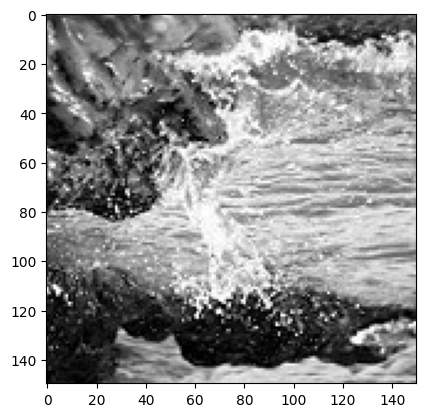

Transformed image 9 predicted as glacier
ColorJitter(brightness=(0.5, 1.5), contrast=None, saturation=None, hue=None)


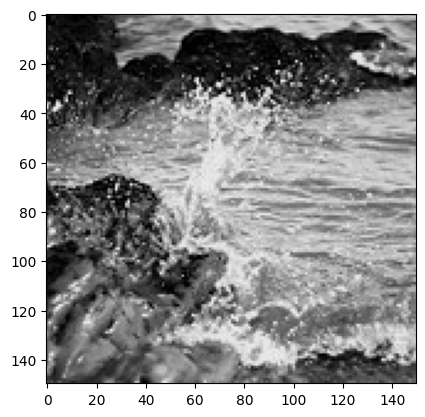

Transformed image 9 predicted as glacier
ColorJitter(brightness=None, contrast=(0.5, 1.5), saturation=None, hue=None)


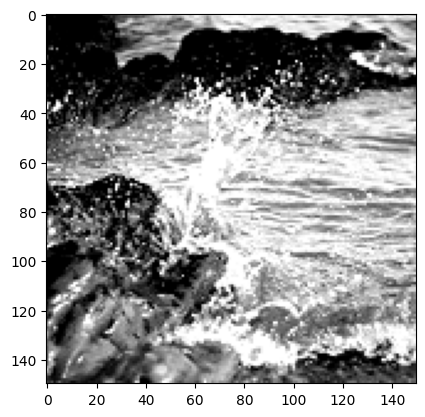

Transformed image 9 predicted as glacier
ColorJitter(brightness=None, contrast=None, saturation=(0.5, 1.5), hue=None)


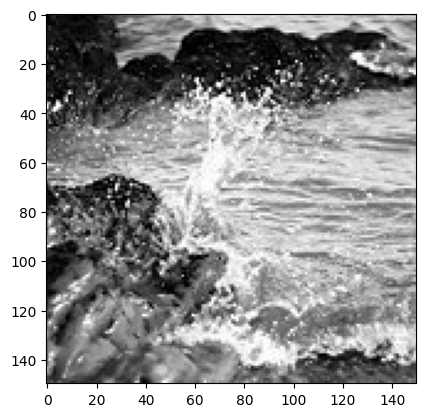

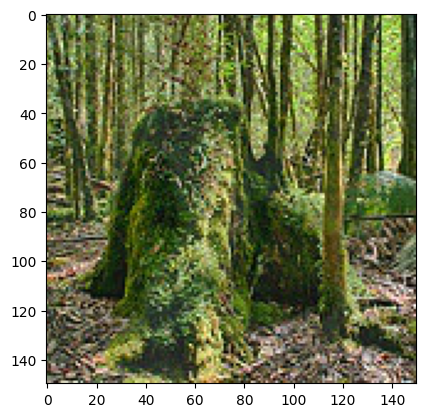

Transformed image 10 predicted as glacier
RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)


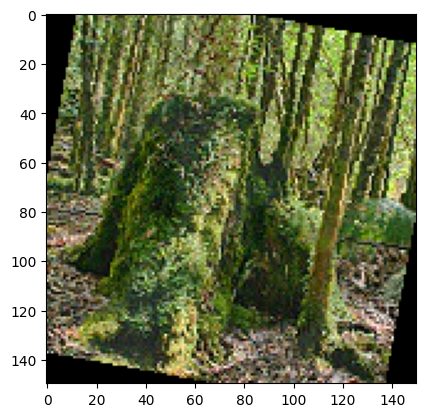

Transformed image 10 predicted as forest
RandomHorizontalFlip(p=0.5)


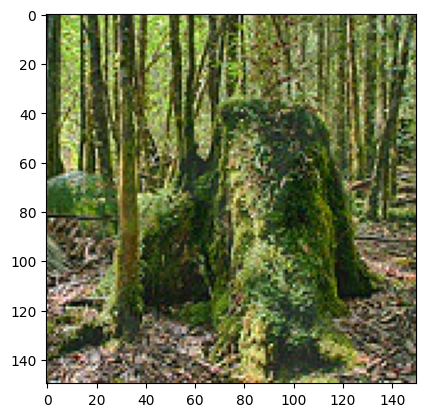

Transformed image 10 predicted as forest
RandomVerticalFlip(p=0.5)


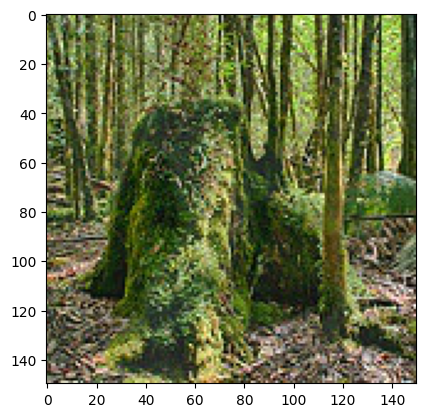

Transformed image 10 predicted as forest
ColorJitter(brightness=(0.5, 1.5), contrast=None, saturation=None, hue=None)


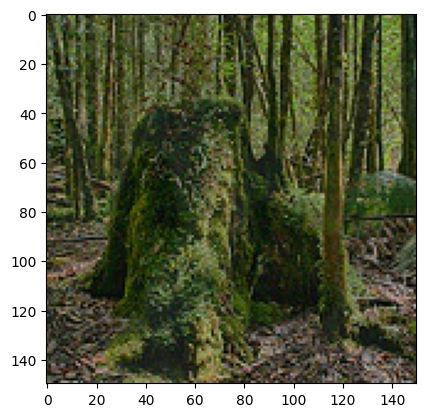

Transformed image 10 predicted as forest
ColorJitter(brightness=None, contrast=(0.5, 1.5), saturation=None, hue=None)


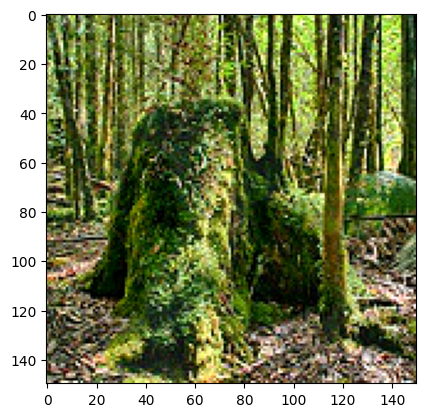

Transformed image 10 predicted as forest
ColorJitter(brightness=None, contrast=None, saturation=(0.5, 1.5), hue=None)


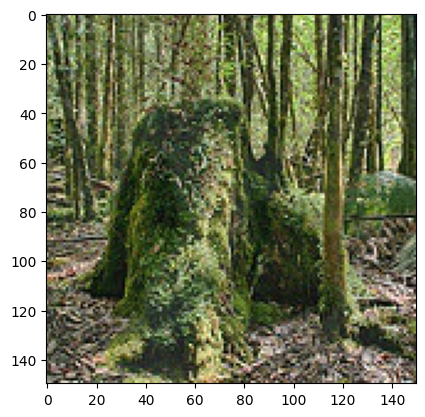

In [ ]:
# YOUR CODE HERE for predicting the labels of an image for the 6 image transformations

from PIL import Image
import os

test_dir = "/content/Image_Transformations/testing"
for i, filename in enumerate(os.listdir(test_dir)):
    # Load the test sample
    image_path = os.path.join(test_dir, filename)
    image = Image.open(image_path)

    # Plot the original image
    plt.imshow(image)
    plt.show()


    # Iterate over the six transformations
    for transform in transformations:
        # Apply the transformation
        transformed_image = transform(image)

        # Define the loader object
        loader = transforms.Compose([
            transforms.Resize((150,150)),
            transforms.ToTensor()])

        # Define the image loader function
        def image_loader(image):
            image = loader(image).to(device)
            image = image.unsqueeze(0) # To pass single image through the model
            return image

        # Convert the image type, if required
        transformed_image = transformed_image.convert("RGB")

        # Load the transformed image
        transformed_image = image_loader(transformed_image)

        # Pass the transformed image through the model to predict the label
        outputs = model(transformed_image)
        _, predicted = torch.max(outputs.data, 1)

        # Ensure the transformed test sample gives the correct prediction and visualize the same
        class_names = ["buildings", "forest", "glacier", "mountain", "sea", "street"]
        predicted_class = class_names[predicted.item()]
        print(f"Transformed image {i+1} predicted as {predicted_class}")
        print(transform)
        plt.imshow(transformed_image.squeeze().permute(1, 2, 0).cpu())
        plt.show()